In [1]:
from glob import glob
from collections import Counter
from collections import defaultdict

import scanpy as sc
import matplotlib.pyplot as plt
import pandas as pd
import anndata as ad
import numpy as np
import scipy.sparse as sp
import seaborn as sns
import gseapy as gp
import gseapy.plot as gplot

sc.set_figure_params(dpi=300, dpi_save=300)

In [2]:
def calc_umap(adata):
    # Run neighbors and UMAP
    sc.pp.neighbors(adata, n_neighbors=15)  # Use PCA representation
    sc.tl.umap(adata)
    return adata

def plot_umap(adata, outfile='./plots/nano_umap.png'):
    fig, ax = plt.subplots(1, 1, figsize=(8, 8))

    # Remove frame around each subplot
    ax.spines["top"].set_visible(False)
    ax.spines["right"].set_visible(False)
    ax.spines["left"].set_visible(False)
    ax.spines["bottom"].set_visible(False)
    ax.tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)
    ax.set_xlabel(None)
    ax.set_ylabel(None)
    
    sc.pl.umap(adata, color='sample', title='UMAP of all samples', show=False, ax=ax)
    # Modify legend labels to replace "_" with space
    legend = ax.get_legend()
    if legend:
        for text in legend.get_texts():
            text.set_text(text.get_text().replace("sample", "Sample").replace("_", " "))
    plt.savefig(outfile, dpi=300, bbox_inches='tight')
    plt.show()

# Read and merge data

In [3]:
#Read .h5ad files with with Seurat annotations
files = sorted(glob('../data/h5_filt_seurat/*.h5ad'))
adata_list = [sc.read_h5ad(file) for file in files]

for adata in adata_list:
    adata.obs.rename(columns={"predicted.celltype": "Seurat"}, inplace=True)
    X = adata.X
    print(f"min={X.min():.3f}, max={X.max():.3f}, mean={X.mean():.3f}")
    vals = np.sort(adata.X.data if hasattr(X, "data") else X.ravel())
    print("min 5 values:", vals[:5])
# log1p already applied on data!

min=0.000, max=5.507, mean=0.027
min 5 values: [0.00660034 0.00660034 0.00660034 0.00660034 0.00660034]
min=0.000, max=5.373, mean=0.027
min 5 values: [0.00961527 0.00961527 0.00961527 0.00961527 0.00961527]
min=0.000, max=5.304, mean=0.030
min 5 values: [0.00463369 0.00463369 0.00463369 0.00463369 0.00463369]
min=0.000, max=6.172, mean=0.030
min 5 values: [0.00493161 0.00493161 0.00493161 0.00493161 0.00493161]


In [4]:
#Read CoDi and CoDi_dist annotations from .csv files
a_files = sorted(glob('../data/annotations/*.csv'))
annotation_list = [pd.read_csv(file, index_col="cell_id") for file in a_files]

# Merge CoDI and CoDi_dist annotations with the corresponding AnnData objects
# Ensure that the indices of the annotations match the indices of the AnnData objects
for i, adata in enumerate(adata_list):
    adata.obs = pd.merge(adata.obs, annotation_list[i], left_index=True, right_index=True, how="inner")

In [5]:
for adata in adata_list:
    print(adata)

AnnData object with n_obs × n_vars = 8729 × 22613
    obs: 'nCount_RNA', 'nFeature_RNA', 'RNA_snn_res.0.3', 'seurat_clusters', 'predicted.id', 'prediction.score.CD14..monocyte', 'prediction.score.Dendritic.cell', 'prediction.score.Cytotoxic.T.cell', 'prediction.score.Plasmacytoid.dendritic.cell', 'prediction.score.B.cell', 'prediction.score.Natural.killer.cell', 'prediction.score.CD4..T.cell', 'prediction.score.Megakaryocyte', 'prediction.score.Unassigned', 'prediction.score.max', 'predicted.celltype.score', 'Seurat', 'CoDi', 'CoDi_confidence', 'CoDi_dist', 'CoDi_confidence_dist', 'CoDi_contrastive', 'CoDi_confidence_contrastive'
    var: 'vf_vst_counts_mean', 'vf_vst_counts_variance', 'vf_vst_counts_variance.expected', 'vf_vst_counts_variance.standardized', 'vf_vst_counts_variable', 'vf_vst_counts_rank', 'var.features', 'var.features.rank'
    obsm: 'X_pca', 'X_ref.pca', 'X_ref.umap', 'X_umap'
    layers: 'counts'
AnnData object with n_obs × n_vars = 12676 × 23206
    obs: 'nCount_RNA

In [6]:
cell_types_to_analyse_by_annotation = [
    ['B cell', 'CD14+ monocyte', 'CD4+ T cell', 'Cytotoxic T cell'],
    ['B cell', 'CD14+ monocyte', 'CD4+ T cell', 'Cytotoxic T cell', 'Natural killer cell'],
    ['B cell', 'CD14+ monocyte', 'CD4+ T cell', 'Cytotoxic T cell', 'Natural killer cell']
]
cell_type_cols = ["Seurat","CoDi", "CoDi_dist"]  # Annotation column name

In [7]:
#Pepare the data for merging
sample_names = ['Sample 1 - 40 nm NPs', 'Sample 2 - 200 nm NPs', 'Sample 3 - 40 + 200 nm NPs', 'Sample 4 - control']
samples = []
for i, adata in enumerate(adata_list):
    sample = f'sample_{i+1}'
    adata.obs['sample'] = sample # Add a column 'sample' to keep track of the sample source
    adata.obs.index = [f"{f'sample_{i+1}'}_{x}" for x in adata.obs.index]  # Modify the index to be unique
    samples.append(sample)
# Merge all AnnData objects
merged_adata =  ad.concat(adata_list, axis=0, join='inner')
merged_adata.X = merged_adata.layers['counts'].copy()  # Return raw counts
sc.pp.normalize_total(merged_adata, target_sum=1e4)  # Merge the datasets on raw counts, then run a single normalization + log1p 
sc.pp.log1p(merged_adata)
# Export merged file for any further analysis
merged_adata.write_h5ad('../data/merged.h5ad', compression='gzip')

In [8]:
merged_adata

AnnData object with n_obs × n_vars = 34078 × 20388
    obs: 'nCount_RNA', 'nFeature_RNA', 'RNA_snn_res.0.3', 'seurat_clusters', 'predicted.id', 'prediction.score.CD14..monocyte', 'prediction.score.Dendritic.cell', 'prediction.score.Cytotoxic.T.cell', 'prediction.score.Plasmacytoid.dendritic.cell', 'prediction.score.B.cell', 'prediction.score.Natural.killer.cell', 'prediction.score.CD4..T.cell', 'prediction.score.max', 'predicted.celltype.score', 'Seurat', 'CoDi', 'CoDi_confidence', 'CoDi_dist', 'CoDi_confidence_dist', 'CoDi_contrastive', 'CoDi_confidence_contrastive', 'sample'
    uns: 'log1p'
    obsm: 'X_pca', 'X_ref.pca', 'X_ref.umap', 'X_umap'
    layers: 'counts'

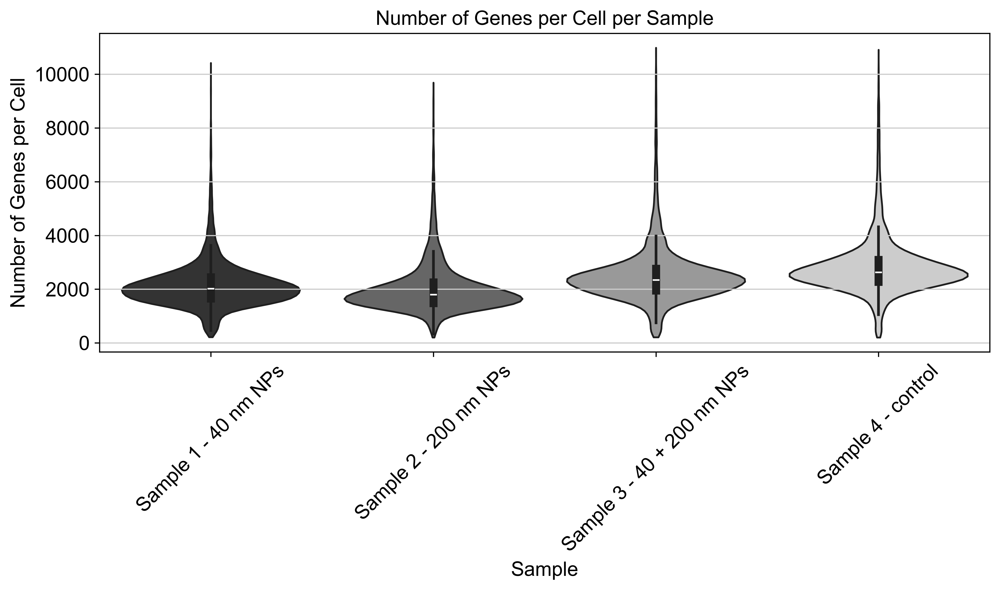

In [8]:
# Combine data into a single DataFrame for visualization
qc_data = []

for adata, sample_name in zip(adata_list, sample_names):
    # Calculate the number of genes per cell
    adata.obs['n_genes_per_cell'] = (adata.X > 0).sum(axis=1)  # For sparse matrix compatibility
    qc_data.append(pd.DataFrame({'Sample': sample_name, 'n_genes_per_cell': adata.obs['n_genes_per_cell']}))

# Combine QC data from all samples
qc_df = pd.concat(qc_data, ignore_index=True)

# Create a violin plot
plt.figure(figsize=(10, 6))
sns.violinplot(data=qc_df, x='Sample', hue='Sample', y='n_genes_per_cell', inner='box', palette='grey', cut=0)

# Customize the plot
plt.title('Number of Genes per Cell per Sample')
plt.ylabel('Number of Genes per Cell')
plt.xlabel('Sample')
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('./plots/nano_h5_qc.png', dpi=300, bbox_inches='tight')
# Show the plot
plt.show()


In [ ]:
# Calculate QC metrics for each AnnData object
# for adata in adata_list:
#     sc.pp.calculate_qc_metrics(adata, inplace=True)

# # Access the results
# for sample_name, adata in zip(samples, adata_list):
#     print(f"{sample_name} - Number of genes per cell statistics:")
#     print(f"Min: {adata.obs['n_genes_by_counts'].min()}")
#     print(f"Max: {adata.obs['n_genes_by_counts'].max()}")
#     print(f"Mean: {adata.obs['n_genes_by_counts'].mean()}")

In [ ]:
# ============================================================
# COMPUTE UMAP (Before Harmony)
# ============================================================
print("Computing neighbors and UMAP (before Harmony)...")
sc.pp.neighbors(merged_adata, n_neighbors=15, n_pcs=50, use_rep='X_pca')
sc.tl.umap(merged_adata)
# Store original UMAP coordinates
adata.obsm['X_umap_before'] = adata.obsm['X_umap'].copy()
print(f"UMAP (before Harmony) computed: {merged_adata.obsm['X_umap_before'].shape}")

# ============================================================
# HARMONY BATCH CORRECTION
# ============================================================
# ! pip install harmonypy
import harmonypy as hm

logger.info("Running Harmony batch correction...")

# Run Harmony on PCA embeddings
harmony_out = hm.run_harmony(
    merged_adata.obsm['X_pca'],
    merged_adata.obs,
    'CoDi_dist',
    max_iter_harmony=20
)


# Store Harmony-corrected PCA
merged_adata.obsm['X_pca_harmony'] = harmony_out.Z_corr
print(f"Harmony correction complete: {merged_adata.obsm['X_pca_harmony'].shape}")

# Compute neighbors using Harmony-corrected PCA
sc.pp.neighbors(merged_adata, n_neighbors=15, n_pcs=50, use_rep='X_pca_harmony')
sc.tl.umap(merged_adata)

# Store Harmony-corrected UMAP
merged_adata.obsm['X_umap_after'] = merged_adata.obsm['X_umap'].copy()
print(f"UMAP (after Harmony) computed: {merged_adata.obsm['X_umap_after'].shape}")

# List all embeddings
print("\nEmbeddings in AnnData:")
for key in merged_adata.obsm.keys():
    print(f"  {key}: {merged_adata.obsm[key].shape}")

# Save AnnData
output_h5ad = Path('../data/merged_harmony.h5ad')
adata.write_h5ad(output_h5ad, compression='gzip')
logger.info(f"AnnData saved to {output_h5ad}")

# Summary
print("\n" + "="*60)
print("ANALYSIS COMPLETE - Summary of Outputs")
print("="*60)
print(f"\nAnnData: {output_h5ad}")
print("  - X_pca: Original PCA")
print("  - X_pca_harmony: Harmony-corrected PCA")
print("  - X_umap_before: UMAP before Harmony")
print("  - X_umap_after: UMAP after Harmony")

# Cell annotation overview

scRNA reference cell types for PBMC (cells.umi.new.txt, counts.umi.txt.gz, genes.umi.txt and meta.txt) are downloaded from Broad Institute repository (https://singlecell.broadinstitute.org/single_cell/study/SCP424/single-cell-comparison-pbmc-data#study-visualize) and merged into sc.h5ad available in  [gdrive link](https://drive.google.com/file/d/1u3bSTjpIuOwvHsOopd0tmtlO775dK-LV/view?usp=sharing)

In [9]:
# Create a 2x2 subplot
import gdown, os


#download reference data
if (os.path.exists('../data/ref_broad_pbmc/sc.h5ad') == False):
    gdown.download(
        "https://drive.google.com/uc?id=1u3bSTjpIuOwvHsOopd0tmtlO775dK-LV",
        "../data/ref_broad_pbmc/sc.h5ad",
        quiet=False
    )
# Read reference annotation data
adata_ref = sc.read_h5ad('../data/ref_broad_pbmc/sc.h5ad')

# Calculate cell type counts and percentages
for cell_type_col in cell_type_cols:
    fig, axes = plt.subplots(2, 2, figsize=(20, 12))
    axes = axes.flatten()
    for i, (adata, ax) in enumerate(zip(adata_list, axes)):
        cell_counts = adata.obs[cell_type_col].value_counts()
        total_cells = cell_counts.sum()
        percentages = (cell_counts / total_cells * 100).round(2)
    
        # Modify categories to include counts and percentages
        updated_categories = [
            f"{cell_type} ({count} [{percentage}%])"
            for cell_type, count, percentage in zip(cell_counts.index, cell_counts, percentages)
        ]
        mapping = dict(zip(cell_counts.index, updated_categories)) 
        adata.obs[cell_type_col + "_updated"] = adata.obs[cell_type_col].map(mapping)#.fillna("Unknown")

        if 'X_umap' not in adata.obsm.keys():
            # Step 1: Normalize and Log Transform
            sc.pp.normalize_total(adata, target_sum=1e4)  # Normalize counts per cell
            sc.pp.log1p(adata)  # Log-transform the data
        
            # Step 2: Identify Highly Variable Genes
            sc.pp.highly_variable_genes(adata, n_top_genes=2000)
            adata = adata[:, adata.var['highly_variable']]  # Subset to HVGs
        
            # Step 3: Scale the Data
            sc.pp.scale(adata, max_value=10)  # Standardize the data
        
            # Step 4: PCA
            sc.tl.pca(adata, n_comps=50)
        
            # Step 5: Compute the Neighbors Graph
            sc.pp.neighbors(adata, n_neighbors=15, n_pcs=20)  # Use first 20 PCs
        
            # Step 6: Compute UMAP
            sc.tl.umap(adata)

        # Plot UMAP
        sc.pl.umap(
            adata,
            color=cell_type_col + "_updated",
            ax=ax,
            show=False,
            title=sample_names[i],
            legend_loc="right margin"
        )
        ax.set_title(f'{sample_names[i]} ({len(adata)} cells)', size=18)
        # Remove frame around each subplot
        ax.spines["top"].set_visible(False)
        ax.spines["right"].set_visible(False)
        ax.spines["left"].set_visible(False)
        ax.spines["bottom"].set_visible(False)
        ax.tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)
        # Increase the legend font size
        legend = ax.get_legend()
        if legend:
            for text in legend.get_texts():
                text.set_fontsize(14)  # Adjust the font size
        ax.set_xlabel(None)
        ax.set_ylabel(None)


    # Add a horizontal legend at the bottom of the figure with reference cell types
    # Define legend items and title
    data = Counter(adata_ref.obs['CellType'])
    total = sum(data.values())
    # percentages = {key: np.round(value / total, 2) * 100 for key, value in data.items()}
    legend_items = [f'{key}: {np.round(value / total * 100, 2)}' for key, value in data.items() if not str(key) in ['Unassigned', 'nan']]

    fig.text(
        0.5, -0.1,  # Position: centered horizontally, slightly below the figure
        "Cell types from Reference sample (Broad): \n" + "%\n ".join(legend_items) + '%',  # Legend text
        ha='center', va='center', fontsize=22  # Alignment and font size
    )

    # Adjust layout and display
    plt.tight_layout()
    plt.savefig('./plots/nano_h5_'+cell_type_col+'.png', dpi=300, bbox_inches='tight')
    plt.show()


/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map)

/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map)

/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map)

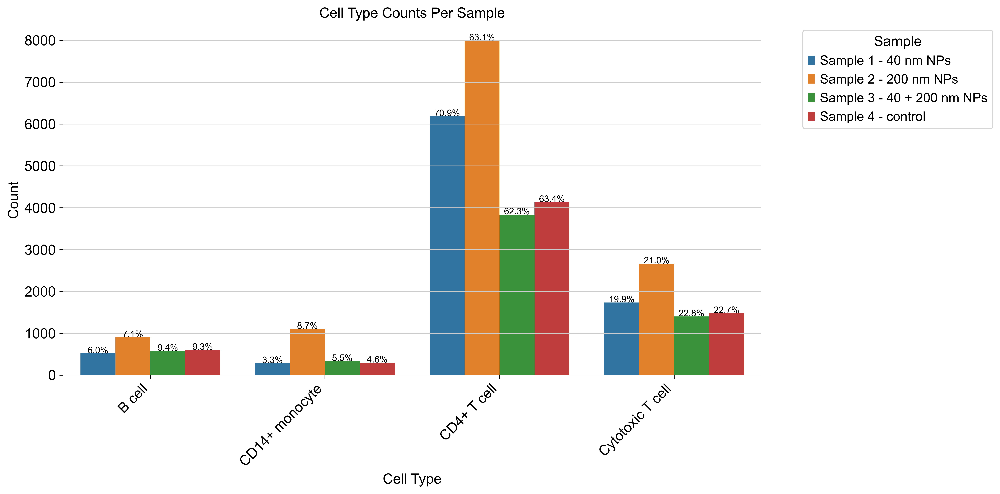

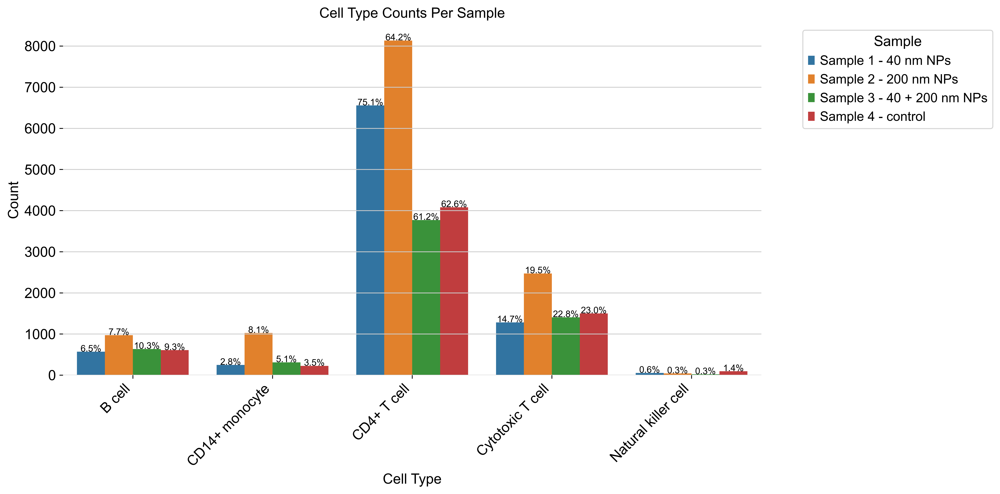

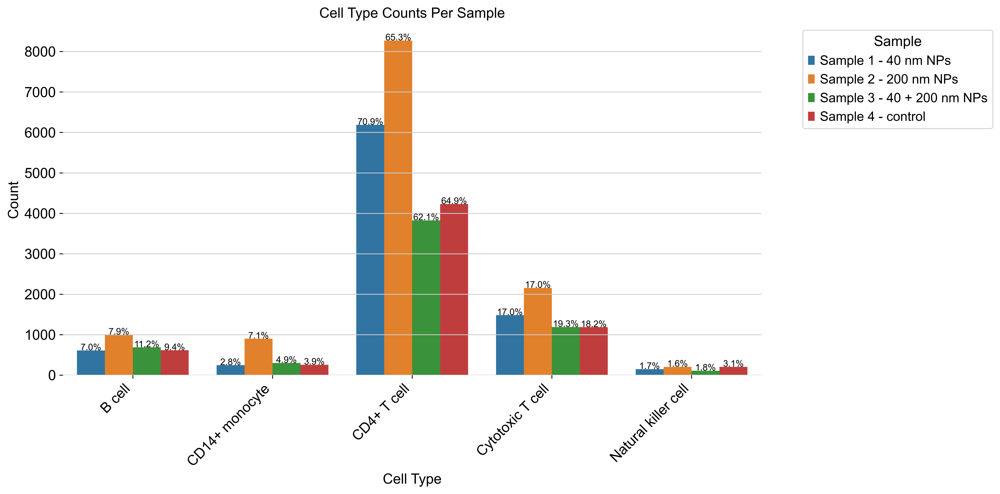

In [10]:
# Define the specific cell types to include in the plot
cell_types_to_analyse_by_annotation = [
    ['B cell', 'CD14+ monocyte', 'CD4+ T cell', 'Cytotoxic T cell'],
    ['B cell', 'CD14+ monocyte', 'CD4+ T cell', 'Cytotoxic T cell', 'Natural killer cell'],
    ['B cell', 'CD14+ monocyte', 'CD4+ T cell', 'Cytotoxic T cell', 'Natural killer cell']
]
# Combine the data from adata_list into a single DataFrame
for j, cell_types_to_analyse in enumerate(cell_types_to_analyse_by_annotation):
    data = []
    for i, adata in enumerate(adata_list):
        sample_name = f"Sample {i+1}"
        total_cells = len(adata)  # Total cells in the sample
        celltype_counts = adata.obs[cell_type_cols[j]].value_counts()
        for celltype in cell_types_to_analyse:
            count = celltype_counts.get(celltype, 0)  # Get count or 0 if cell type is absent
            percentage = (count / total_cells) * 100
            data.append({'Sample': sample_names[i], 'Cell Type': celltype, 'Count': count, 'Percentage': percentage})

    # Create a DataFrame for plotting
    df = pd.DataFrame(data)

    # Set up the plot
    plt.figure(figsize=(14, 7))
    sns.barplot(data=df, x='Cell Type', y='Count', hue='Sample', palette='tab10')

    # Annotate the plot with percentages
    for bar, percentage in zip(plt.gca().patches, df['Percentage']):
        height = bar.get_height()
        plt.gca().text(
            bar.get_x() + bar.get_width() / 2,
            height + 5,  # Position above the bar
            f"{percentage:.1f}%",
            ha="center",
            fontsize=9,
            color="black"
        )

# Customize the plot
    plt.xticks(rotation=45, ha='right')
    plt.title('Cell Type Counts Per Sample')
    plt.ylabel('Count')
    plt.xlabel('Cell Type')
    plt.legend(title='Sample', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.box(None)

# Show the plot
    plt.savefig('./plots/nano_ct_per_sample_h5_'+cell_type_cols[j]+'.png', dpi=300, bbox_inches='tight')
    plt.show()


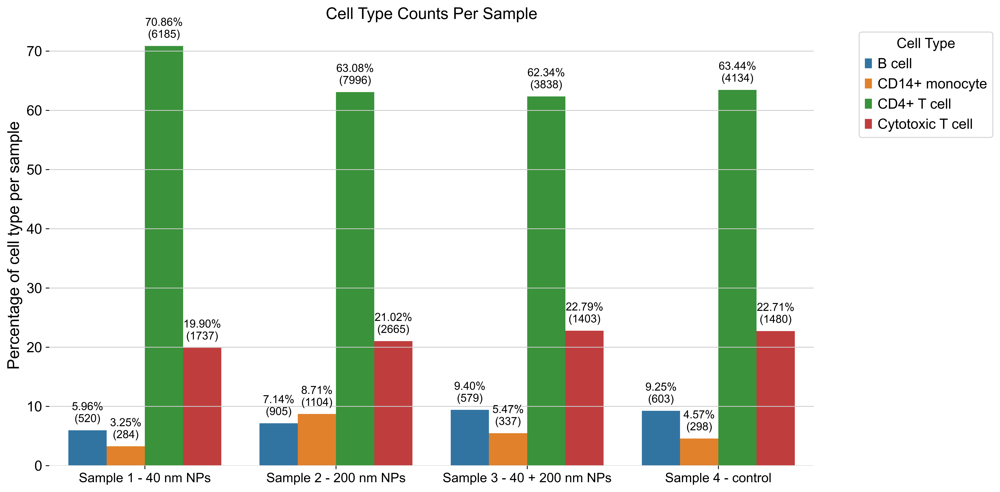

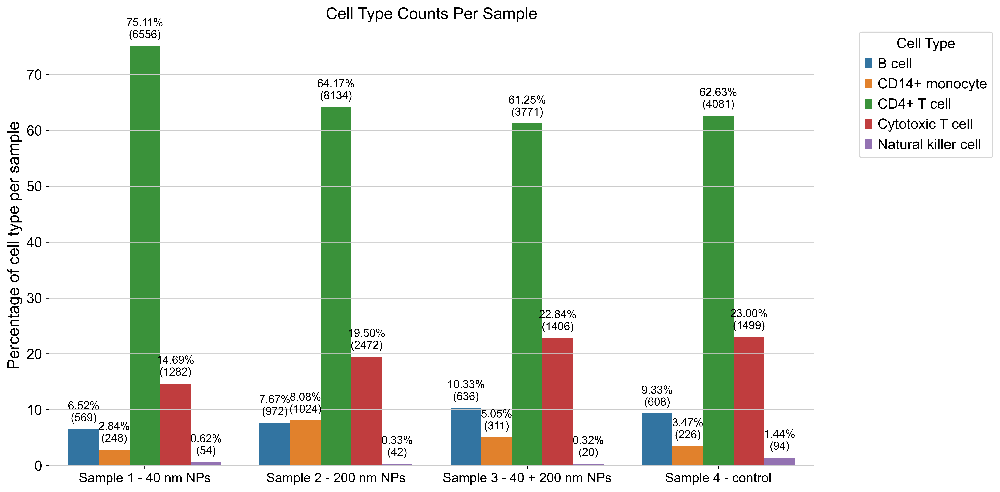

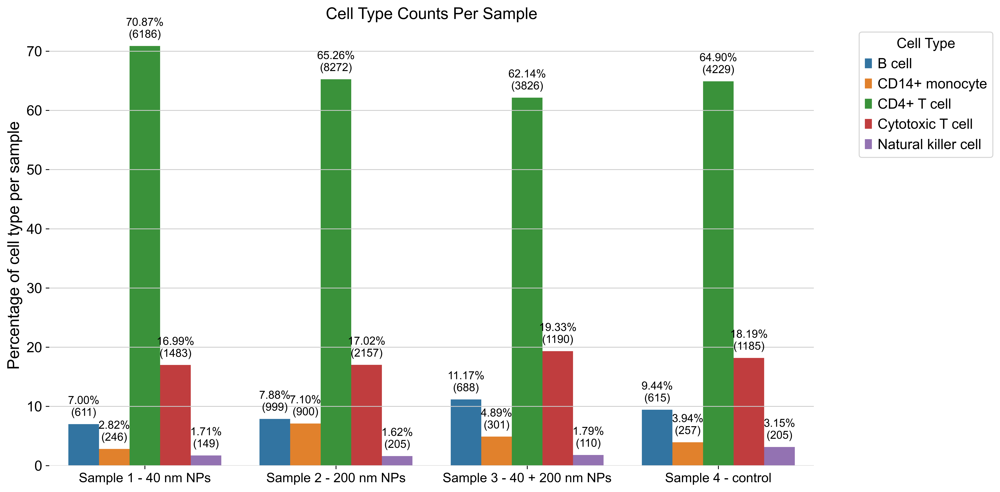

In [11]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib
matplotlib.rcParams['font.family'] = 'Arial'
# Combine the data from adata_list into a single DataFrame




for j, cell_types_to_analyse in enumerate(cell_types_to_analyse_by_annotation):
    data = []
    for i, adata in enumerate(adata_list):
        sample_name = f"Sample {i+1}"
        total_cells = len(adata)  # Total cells in the sample
        celltype_counts = adata.obs[cell_type_cols[j]].value_counts()
        for celltype in cell_types_to_analyse:
            count = celltype_counts.get(celltype, 0)  # Get count or 0 if cell type is absent
            percentage = (count / total_cells) * 100
            data.append({'Sample': sample_names[i], 'Cell Type': celltype, 'Count': count, 'Percentage': percentage})
    
    # Create a DataFrame for plotting
    df = pd.DataFrame(data)
    
    # Set up the plot with samples on the x-axis and cell types grouped
    plt.figure(figsize=(14, 7))
    ax = sns.barplot(data=df, x='Sample', y='Percentage', hue='Cell Type', palette='tab10')
    
    # Annotate the plot with percentages
    for container, cell_type in zip(ax.containers, cell_types_to_analyse):
        for bar, percentage, count in zip(container, df[df['Cell Type'] == cell_type]['Percentage'], 
                                         df[df['Cell Type'] == cell_type]['Count']):
            height = bar.get_height()
            ax.text(
                bar.get_x() + bar.get_width() / 2,
                height + 1,  # Position above the bar
                f"{percentage:.2f}%\n({count})",
                ha="center",
                va="bottom",
                fontsize=11,
                color="black"
            )
    
    # Customize the plot
    plt.xticks(rotation=0, ha='center', size=13)
    plt.title('Cell Type Counts Per Sample', size=16)
    plt.ylabel('Percentage of cell type per sample', size=16)
    plt.xlabel(None)
    plt.legend(title='Cell Type', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=14)
    plt.tight_layout()
    plt.box(False)
    plt.savefig(f'./plots/nano_sample_per_ct_h5_{cell_type_cols[j]}.png', dpi=300, bbox_inches='tight')
    
    # Show the plot
    plt.show()

# Differential expression

In [9]:
import numpy as np
import pandas as pd
from collections import Counter
import scanpy as sc

results_all_degs_all_annotations = dict()
results_significant_degs_all_annotations = dict()

for j, cell_type_col in enumerate(cell_type_cols):
    if cell_type_col != 'CoDi_dist':
        continue
    weight_pow_thr = 0.5
    cell_type_count_dict = {}

    # Count cells per cell type in each sample
    for i, sample in enumerate(samples):
        cnt = Counter(adata_list[i].obs[cell_type_col])
        cell_type_count_dict[sample] = cnt

    # Subset for the selected cell types
    cell_types = cell_types_to_analyse_by_annotation[j]
    adata_subset = merged_adata[merged_adata.obs[cell_type_col].isin(cell_types)].copy()

    # (Assume adata_subset.layers["counts"] already contains raw counts)
    # Do NOT re-normalize; use adata_subset.X as normalized+log1p for the DE test

    results_all_degs = {ct: dict() for ct in cell_types}
    results_significant_degs = {ct: dict() for ct in cell_types}

    for cell_type in cell_types:
        cell_type_data = adata_subset[adata_subset.obs[cell_type_col] == cell_type]

        for sample in ["sample_1", "sample_2", "sample_3"]:
            # Compare each sample vs reference (sample_4)
            cell_type_data_sample = cell_type_data[cell_type_data.obs["sample"].isin([sample, "sample_4"])]

            # --- 1️⃣ DE statistical test on log1p-normalized data ---
            sc.tl.rank_genes_groups(
                cell_type_data_sample,
                groupby="sample",
                reference="sample_4",
                method="wilcoxon",
                pts=True,
                use_raw=False,
                layer=None,
            )

            # --- 2️⃣ Get DE results and recompute log2FC from raw counts ---
            degs_df = sc.get.rank_genes_groups_df(cell_type_data_sample, group=sample)

            pseudo = 1 # 0.1  # good for count data
            mask_sample = cell_type_data_sample.obs["sample"] == sample
            mask_ref = cell_type_data_sample.obs["sample"] == "sample_4"

            X_counts = cell_type_data_sample.layers["counts"]
            if hasattr(X_counts, "toarray"):
                X_counts = X_counts.toarray()

            mean_sample = np.asarray(X_counts[mask_sample, :].mean(axis=0)).ravel() + pseudo
            mean_ref = np.asarray(X_counts[mask_ref, :].mean(axis=0)).ravel() + pseudo

            log2fc_linear = np.log2(mean_sample / mean_ref)

            # Align with Scanpy's gene list and replace FC values
            degs_df["log2FC_linear"] = log2fc_linear[
                np.isin(cell_type_data_sample.var_names, degs_df["names"])
            ]
            degs_df["log2FC_linear_abs"] = np.abs(degs_df["log2FC_linear"])

            # --- 3️⃣ Weighted adjusted p-values ---
            degs_df["pvals_adj_weighted"] = (
                degs_df["pvals_adj"]
                * np.power(cell_type_count_dict[sample].most_common(1)[0][1], weight_pow_thr)
                / np.power(cell_type_count_dict[sample][cell_type], weight_pow_thr)
            )

            # --- 4️⃣ Clean up infinities and sort ---
            degs_df = degs_df.replace([np.inf, -np.inf, np.nan], None).dropna()
            degs_df = degs_df.sort_values(by="pvals_adj", ascending=False)

            # --- 5️⃣ Filter significant and top DEGs ---
            significant_degs = degs_df[degs_df["pvals_adj"] < 0.05]

            results_all_degs[cell_type][sample] = degs_df
            results_significant_degs[cell_type][sample] = significant_degs

            print(f"{cell_type} | {sample}: significant={len(significant_degs)}")

    results_all_degs_all_annotations[cell_type_col] = results_all_degs
    results_significant_degs_all_annotations[cell_type_col] = results_significant_degs

def write_to_excel(fname, dict_res):
    # Create an Excel writer object to save all sheets in a single file
    with pd.ExcelWriter(fname, engine='xlsxwriter') as writer:
        for ct, dct in dict_res.items():
            for sample, df in dct.items():
                ct_name = ct.replace(' ', '_')
                if 'significance' in df.columns:
                    df = df[df['significance'] != 'Not Significant']
                    df = df.sort_values(by='pvals_adj', ascending=True)
                    data_type = 'genes'
                else:
                    data_type = 'pathways'
                sheet_name = f'{ct_name}_{sample}'
                df.to_excel(writer, sheet_name=sheet_name[:31], index=False)  # Excel sheet names must be <= 31 characters
                print(f'    {ct}, {sample}: {len(df)} {data_type}')

for cell_type_col in cell_type_cols:
    if cell_type_col != 'CoDi_dist':
        continue
        
    print('DEGs:')
    write_to_excel('./results/de_results_'+cell_type_col+'.xlsx', results_all_degs_all_annotations[cell_type_col])

/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()


B cell | sample_1: significant=1665


/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()


B cell | sample_2: significant=2359


/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()


B cell | sample_3: significant=493


/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()


CD14+ monocyte | sample_1: significant=3807


/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()


CD14+ monocyte | sample_2: significant=5907


/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()


CD14+ monocyte | sample_3: significant=3502


/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()


CD4+ T cell | sample_1: significant=7226


/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()


CD4+ T cell | sample_2: significant=8143


/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()


CD4+ T cell | sample_3: significant=2690


/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()


Cytotoxic T cell | sample_1: significant=1999


/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()


Cytotoxic T cell | sample_2: significant=3528


/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()


Cytotoxic T cell | sample_3: significant=750


/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()


Natural killer cell | sample_1: significant=156


/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()


Natural killer cell | sample_2: significant=356


/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/Users/vladimirk/opt/anaconda3/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()


Natural killer cell | sample_3: significant=62


In [38]:
# Define thresholds for significant DEGs
for j, cell_type_col in enumerate(cell_type_cols):
    if cell_type_col != 'CoDi_dist':
        continue
    results_all_degs = results_all_degs_all_annotations[cell_type_col]
    results_significant_degs = results_significant_degs_all_annotations[cell_type_col] 
    results_top_degs = results_top_degs_all_annotations[cell_type_col]
    logFC_threshold = 0.25 # Satija et al. (2015) – Spatial reconstruction of single-cell gene expression data.
                            # Nature Biotechnology,In Seurat, marker genes are often defined by |avg_logFC| > 0.25 (≈ 1.2-fold).
    adj_p_value_threshold = 0.05
    pval_adj_var = 'pvals_adj'

    # Data structure keys
    cell_types = list(results_all_degs.keys())
    samples_desc = ['Sample 1\n40nm', 'Sample 2\n200nm', 'Sample 3\n40 + 200nm']

    # Create a grid of subplots based on the dimensions of the data
    n_rows = len(cell_types)
    n_cols = len(samples_desc)
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(5 * n_cols, 4 * n_rows), sharex=True, sharey=True)

    # Iterate through cell types and samples
    for i, cell_type in enumerate(cell_types):
        for j, sample in enumerate(samples_desc):
            ax = axes[i, j]

            # Access the dataframe for the current cell type and sample
            df = results_all_degs[cell_type][f"sample_{j + 1}"]

            # Add a column to classify genes based on thresholds
            df['significance'] = 'Not Significant'
#             df.loc[((df['log2FC_linear'] >= logFC_threshold) & (df[pval_adj_var] < adj_p_value_threshold)), 'significance'] = 'Upregulated'
#             df.loc[((df['log2FC_linear'] <= -logFC_threshold) & (df[pval_adj_var] < adj_p_value_threshold)), 'significance'] = 'Downregulated'
            df.loc[((df['log2FC_linear'] > 0) & (df[pval_adj_var] < adj_p_value_threshold)), 'significance'] = 'Upregulated'
            df.loc[((df['log2FC_linear'] < 0) & (df[pval_adj_var] < adj_p_value_threshold)), 'significance'] = 'Downregulated'

            df.loc[:, pval_adj_var] = df[pval_adj_var].apply(lambda x: x if x > 1e-50 else 1e-50)

            # Create the volcano plot for this subplot
            sns.scatterplot(
                data=df,
                x='log2FC_linear', 
                y=-np.log10(df[pval_adj_var]), 
                hue='significance',
                palette={'Not Significant': 'gray', 'Upregulated': 'red', 'Downregulated': 'blue'},
                alpha=0.6,
                s=8,
                edgecolor=None,
                ax=ax
            )

            # Add threshold lines
#             ax.axvline(x=logFC_threshold, color='black', linestyle='--', linewidth=1)
#             ax.axvline(x=-logFC_threshold, color='black', linestyle='--', linewidth=1)
            ax.axhline(y=-np.log10(adj_p_value_threshold), color='green', linestyle='--', linewidth=1)

            # Set subplot title to include current cell type and sample
            num_cells = len(adata_list[j][adata_list[j].obs[cell_type_col] == cell_type])
            ax.set_title(f"{cell_type} - {sample} ({num_cells} cells)", fontsize=14)
            ax.get_legend().remove()

            # Remove x and y labels for subplots
            ax.set_xlabel("")
            ax.set_ylabel("")

            # Remove frame around each subplot
            ax.spines["top"].set_visible(False)
            ax.spines["right"].set_visible(False)
            ax.spines["left"].set_visible(False)
            ax.spines["bottom"].set_visible(False)

            # Annotate the number of upregulated and downregulated genes
            # Count the number of upregulated and downregulated genes
            upregulated_count = len(df[df['significance'] == 'Upregulated'])
            downregulated_count = len(df[df['significance'] == 'Downregulated'])
            ax.text(
                0.3, 0.9, f"{downregulated_count}", 
                color='blue', va='center', ha='right', fontsize=14,
                transform=ax.transAxes  # Use axes coordinates for consistent positioning
            )
            ax.text(
                0.8, 0.9, f"{upregulated_count}", 
                color='red', va='center', ha='left', fontsize=14,
                transform=ax.transAxes  # Use axes coordinates for consistent positioning
            )

    # Add main x and y labels with adjusted positions
    fig.text(0.5, 0.1, 'Log Fold Change', ha='center', fontsize=14)
    fig.text(-0.02, 0.5, '-Log10 Adjusted P-value', va='center', rotation='vertical', fontsize=14)

    # Adjust layout and add a single legend below the figure
    handles, labels = axes[0, 0].get_legend_handles_labels()
    fig.legend(handles, labels, title='Significance', loc='lower center', ncol=3, fontsize=12, bbox_to_anchor=(0.5, 0.05), markerscale=2)

    plt.tight_layout(rect=[0, 0.1, 1, 0.96])  # Adjust lower space for legend
    plt.suptitle(f"Volcano Plots of differential gene expression", fontsize=18)
    plt.savefig(f'./plots/volcano_h5_{pval_adj_var}_{weight_pow_thr}_'+cell_type_col+'.png', dpi=300, bbox_inches='tight')
    plt.show()


B cell: 2913 cells
Plotting heatmap for B cell (22 DEGs)


/var/folders/2h/45bqs84942sfxfwfndsxtgs40000gn/T/ipykernel_22598/154291411.py:80: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


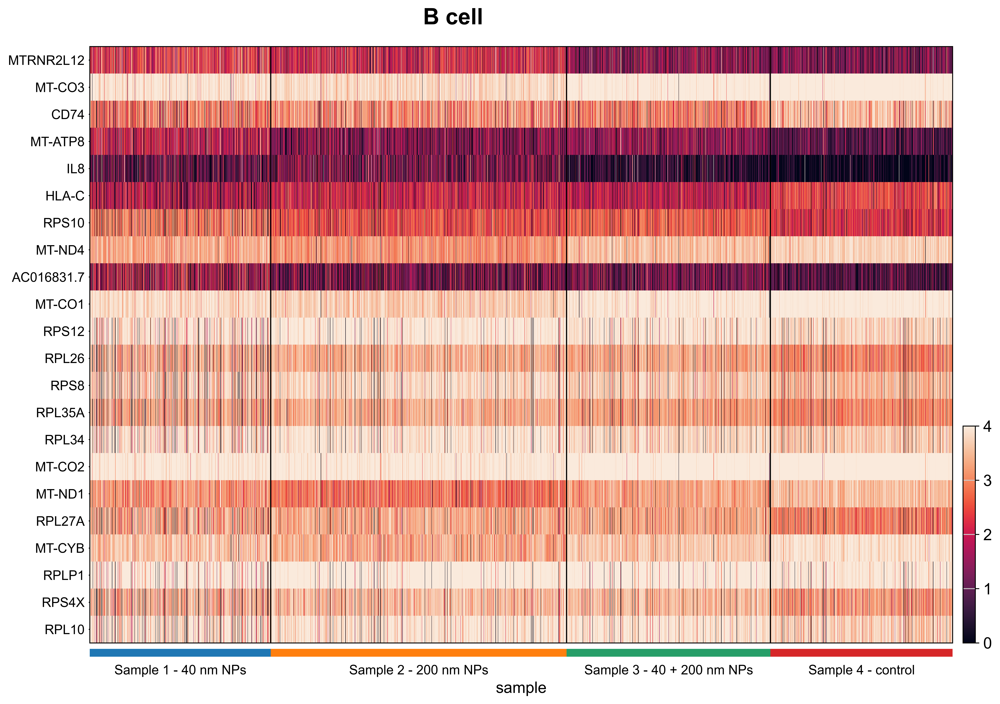

CD14+ monocyte: 1704 cells
Plotting heatmap for CD14+ monocyte (20 DEGs)


/var/folders/2h/45bqs84942sfxfwfndsxtgs40000gn/T/ipykernel_22598/154291411.py:80: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


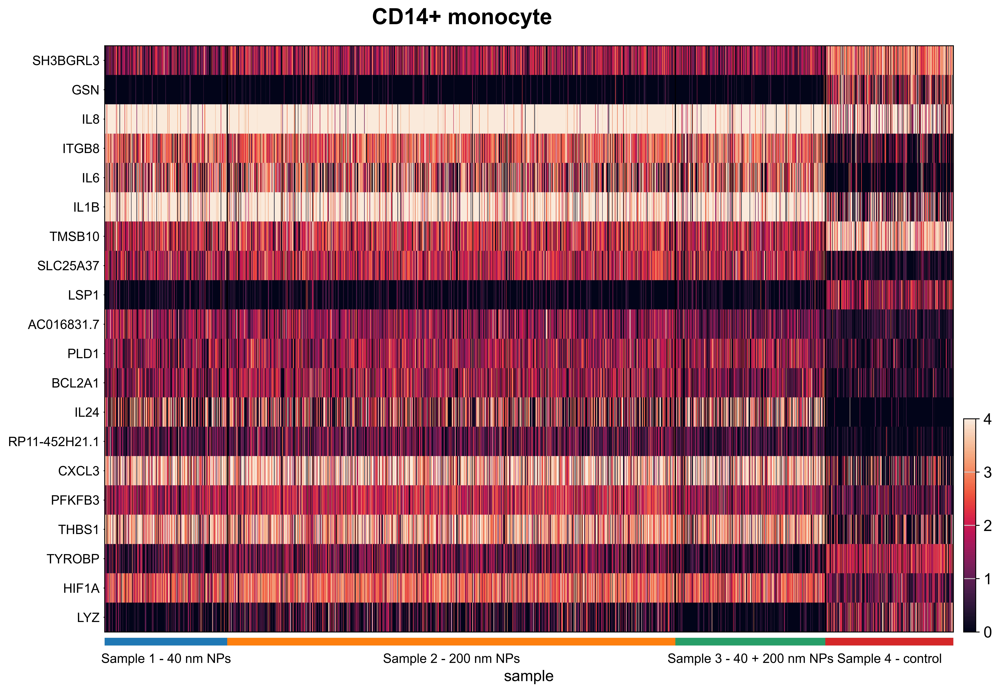

CD4+ T cell: 22513 cells
Plotting heatmap for CD4+ T cell (28 DEGs)


/var/folders/2h/45bqs84942sfxfwfndsxtgs40000gn/T/ipykernel_22598/154291411.py:80: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


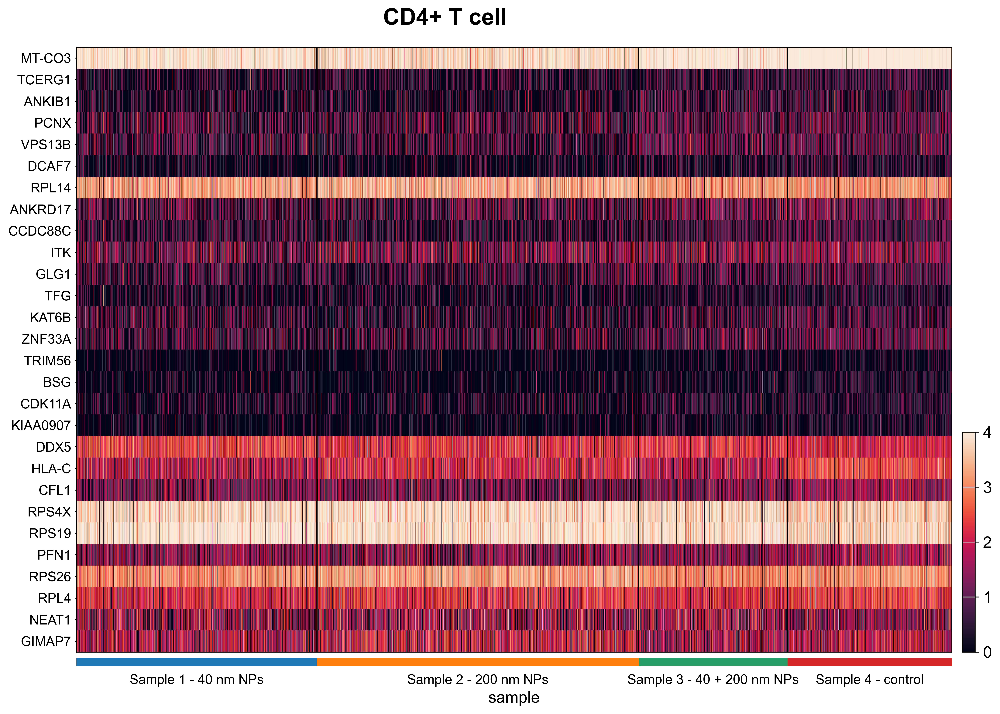

Cytotoxic T cell: 6015 cells
Plotting heatmap for Cytotoxic T cell (28 DEGs)


/var/folders/2h/45bqs84942sfxfwfndsxtgs40000gn/T/ipykernel_22598/154291411.py:80: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


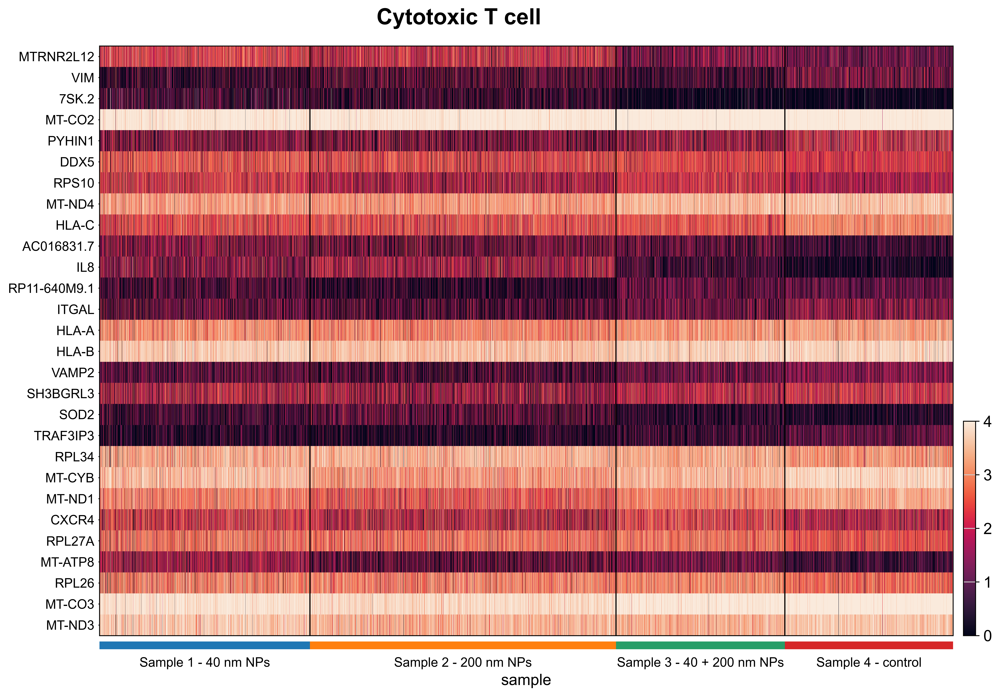

Natural killer cell: 669 cells
Plotting heatmap for Natural killer cell (19 DEGs)


/var/folders/2h/45bqs84942sfxfwfndsxtgs40000gn/T/ipykernel_22598/154291411.py:80: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


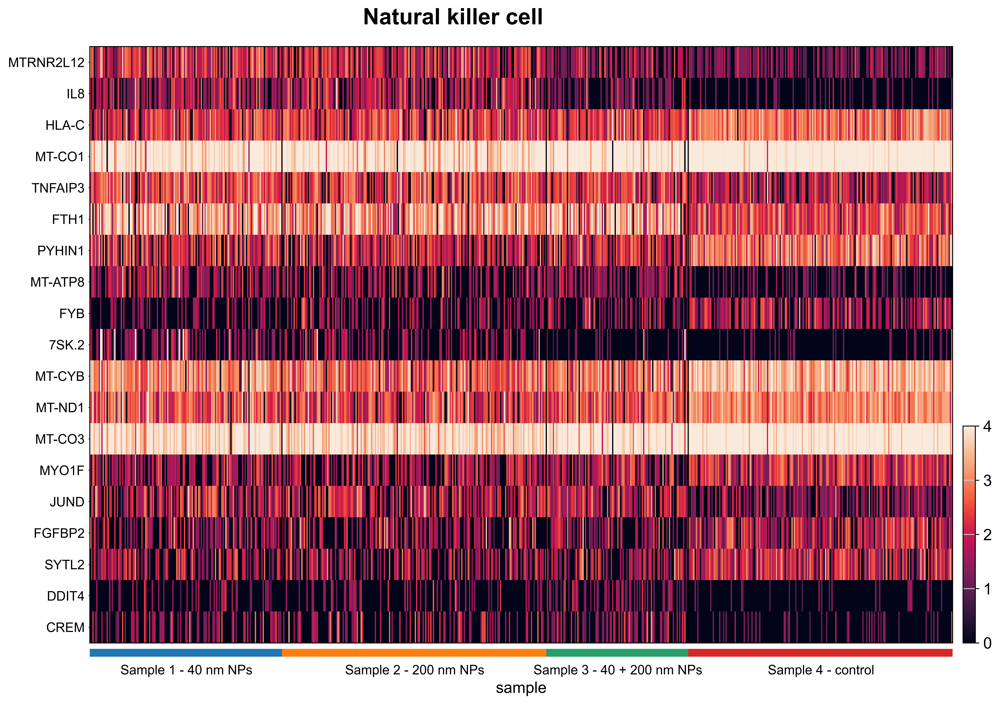

In [32]:
import numpy as np
import matplotlib.pyplot as plt
import scanpy as sc

for j, cell_type_col in enumerate(cell_type_cols):
    if cell_type_col != 'CoDi_dist':
        continue
    results_all_degs = results_all_degs_all_annotations[cell_type_col]
    results_significant_degs = results_significant_degs_all_annotations[cell_type_col]

    sample_names_dict = dict(zip(samples, sample_names))

    for i, ct in enumerate(cell_types_to_analyse_by_annotation[j]):
        # Subset only current cell type
        adata_subset = merged_adata[merged_adata.obs[cell_type_col] == ct].copy()
        adata_subset.obs['sample'] = [sample_names_dict[sample] for sample in adata_subset.obs['sample']]

        print(f"{ct}: {len(adata_subset)} cells")

        # --- Select top 10 DE genes per sample ---
        top_sample1 = (
            results_all_degs[ct]['sample_1']
            [results_all_degs[ct]['sample_1']['significance'] != 'Not Significant']
            .sort_values(by='pvals_adj', ascending=True)['names'][:10]
            .values
        )
        top_sample2 = (
            results_all_degs[ct]['sample_2']
            [results_all_degs[ct]['sample_2']['significance'] != 'Not Significant']
            .sort_values(by='pvals_adj', ascending=True)['names'][:10]
            .values
        )
        top_sample3 = (
            results_all_degs[ct]['sample_3']
            [results_all_degs[ct]['sample_3']['significance'] != 'Not Significant']
            .sort_values(by='pvals_adj', ascending=True)['names'][:10]
            .values
        )

        # Combine and remove duplicates while preserving order
        top_genes_all = list(dict.fromkeys(np.concatenate((top_sample1, top_sample2, top_sample3))))

        print(f"Plotting heatmap for {ct} ({len(top_genes_all)} DEGs)")

        # --- Plot heatmap (log1p-normalized data, true scale) ---
        axs = sc.pl.heatmap(
            adata_subset,
            var_names=top_genes_all,
            groupby="sample",
            use_raw=False,
            layer=None,
            log=False,              # already log1p
            standard_scale=None,    # ✅ preserve true magnitude differences
            vmin=0, vmax=4,         # enhance contrast
            cmap="rocket",
            swap_axes=True,
            figsize=(14, 10),
            show=False
        )

        # --- Move sample labels slightly to the right ---
        if isinstance(axs, dict) and "groupby_ax" in axs and axs["groupby_ax"] is not None:
            gax = axs["groupby_ax"]
            for lab in gax.get_xticklabels():
                lab.set_rotation(0)
                lab.set_ha("center")   # move label text to the right
                lab.set_x(lab.get_position()[0] + 0.05)  # small x-shift
        else:
            gax = plt.gca()
            for lab in gax.get_xticklabels():
                lab.set_rotation(0)
                lab.set_ha("center")
                lab.set_x(lab.get_position()[0] + 0.05)

        # --- Add a centered title above the plot ---
        plt.suptitle(
            f"{ct}", fontsize=20, y=0.95, weight='bold'
        )

        plt.tight_layout()
        plt.savefig(f"./plots/heatmap_h5_{ct}_{cell_type_col}.png", dpi=300, bbox_inches="tight")
        plt.show()


In [ ]:
#!/usr/bin/env python3
"""
Create one heatmap per sample (total 4 heatmaps),
each including the top 6 genes from each of the 5 Excel DE sheets
(30 unique genes), visualized across ALL 4 cell types present
in adata.obs['CoDi_dist'].

Author: <Your Name>
Date: 2025-12-08
"""

import os
import difflib
import logging
import pandas as pd
import matplotlib.pyplot as plt
import scanpy as sc


# =====================================================================
# Logging
# =====================================================================
logging.basicConfig(
    level=logging.INFO,
    format="%(asctime)s - %(levelname)s - %(message)s"
)


# =====================================================================
# Load top genes from Excel
# =====================================================================
def load_top_genes_from_excel(excel_path, n_top=6):
    """
    Load top N genes per sheet (sheet names = 5 cell types).
    Use column: 'names', sorted by pvals_adj ascending.

    Returns:
        dict: sheet_name → [genes]
    """
    excel = pd.ExcelFile(excel_path)
    sheet_names = excel.sheet_names  # 5 cell types defined by user

    sheet_to_genes = {}

    for sheet in sheet_names:
        df = excel.parse(sheet)

        if "pvals_adj" not in df.columns:
            logging.warning(f"Sheet {sheet} missing pvals_adj")
            continue

        if "names" not in df.columns:
            logging.warning(f"Sheet {sheet} missing 'names'")
            continue

        df_sorted = df.sort_values("pvals_adj", ascending=True)
        top = df_sorted["names"].head(n_top).tolist()

        sheet_to_genes[sheet] = top
        logging.info(f"Loaded top {n_top} genes for sheet '{sheet}': {top}")

    return sheet_to_genes


# =====================================================================
# Generate heatmap for a single sample
# =====================================================================
def create_sample_heatmap(adata, gene_list, output_dir):
    """
    Generate one heatmap for a single sample:
        - 30 selected genes
        - ALL cell types in adata.obs['CoDi_dist']
    """

    # Identify sample ID
    sample_id = adata.uns.get("sample_id", "Sample")

    # Filter only genes present in this sample's var_names
    genes_present = [g for g in gene_list if g in adata.var_names]
    missing = set(gene_list) - set(genes_present)

    if missing:
        logging.warning(f"{sample_id}: missing genes {missing}")

    if len(genes_present) == 0:
        logging.warning(f"{sample_id}: none of the genes exist. Skipping heatmap.")
        return

    # Output file
    os.makedirs(output_dir, exist_ok=True)
    out_file = os.path.join(output_dir, f"heatmap_{sample_id}.png")

    # Create heatmap (do NOT let scanpy save by itself)
    sc.pl.heatmap(
        adata,
        var_names=genes_present,
        groupby="CoDi_dist",
        dendrogram=False,
        cmap="viridis",
        figsize=(8, 12),
        show=False,
        save=False
    )

    # Manually save figure
    plt.savefig(out_file, dpi=250, bbox_inches='tight')
    plt.close()

    logging.info(f"Saved sample heatmap → {out_file}")


# =====================================================================
# MAIN
# =====================================================================
def main(adata_list):

    excel_path = "results/de_results_CoDi_dist.xlsx"
    output_dir = "results/heatmaps"

    # -------------------------------------------------------------
    # Step 1: Load top 6 genes per Excel sheet (5 sheets → 30 genes)
    # -------------------------------------------------------------
    sheet_to_genes = load_top_genes_from_excel(excel_path, n_top=6)

    # Merge all 5×6 genes into one unique set
    combined_genes = sorted({g for gl in sheet_to_genes.values() for g in gl})
    logging.info(f"Total genes selected for each heatmap = {len(combined_genes)}")

    # -------------------------------------------------------------
    # Step 2: Generate one heatmap per sample
    # -------------------------------------------------------------
    for adata in adata_list:
        create_sample_heatmap(
            adata=adata,
            gene_list=combined_genes,
            output_dir=output_dir
        )

    logging.info("FINISHED generating all sample heatmaps.")


# =====================================================================
# Entry point (expects your adata_list to already exist)
# =====================================================================
if __name__ == "__main__":
    main(adata_list)


2025-12-08 18:32:16,184 - INFO - Loaded top 6 genes for sheet 'B_cell_sample_1': ['MTRNR2L12', 'MT-CO3', 'CD74', 'MT-ATP8', 'IL8', 'HLA-C']
2025-12-08 18:32:16,367 - INFO - Loaded top 6 genes for sheet 'B_cell_sample_2': ['MT-CO3', 'MT-CYB', 'IL8', 'RPLP1', 'MT-ND4', 'MT-ND1']
2025-12-08 18:32:16,408 - INFO - Loaded top 6 genes for sheet 'B_cell_sample_3': ['RPS10', 'MT-ATP8', 'HLA-C', 'CD74', 'RPL27A', 'MT-CYB']
2025-12-08 18:32:16,683 - INFO - Loaded top 6 genes for sheet 'CD14+_monocyte_sample_1': ['SH3BGRL3', 'GSN', 'IL8', 'ITGB8', 'IL6', 'IL1B']
2025-12-08 18:32:17,545 - INFO - Loaded top 6 genes for sheet 'CD14+_monocyte_sample_2': ['SLC25A37', 'LSP1', 'IL6', 'IL8', 'IL1B', 'PTGS2']
2025-12-08 18:32:17,804 - INFO - Loaded top 6 genes for sheet 'CD14+_monocyte_sample_3': ['TYROBP', 'SH3BGRL3', 'TMSB10', 'ITGB8', 'HIF1A', 'IL6']
2025-12-08 18:32:18,368 - INFO - Loaded top 6 genes for sheet 'CD4+_T_cell_sample_1': ['MT-CO3', 'RPS28', 'RPL38', 'MT-ATP8', 'RPS27', 'RPL27A']
2025-12-08

In [18]:
results_all_degs_all_annotations['CoDi_dist']['B cell']['sample_1'][['names', 'scores']].sort_values('scores', ascending=False)

,names,scores
0,MTRNR2L12,22.924006
1,MT-ATP8,22.045252
2,RPS10,18.020355
3,IL8,17.626312
4,AC016831.7,15.266322
...,...,...
20383,MT-CO1,-15.109028
20384,MT-ND4,-15.289715
20385,MT-CO3,-16.139673
20386,CD74,-16.160887


# Gene set enrichment

In [25]:
databases = ['MSigDB_Hallmark_2020', 'MSigDB_Oncogenic_Signatures']  # 'Reactome_2022', , 'KEGG_2021_Human', GO_Biological_Process_2021
for database in databases:
    results_significant_all_by_annotation = dict()
    results_all_gse_by_annotation = dict()
    for j,cell_type_col in enumerate(cell_type_cols):
        if cell_type_col != 'CoDi_dist':
            continue
        result_all_degs = results_all_degs_all_annotations[cell_type_col]
        results_significant_degs = results_significant_degs_all_annotations[cell_type_col] 


        results_all_gse = {ct: dict() for ct in cell_types}
        results_significant_all = {ct: dict() for ct in cell_types}
        for ct, dct in result_all_degs.items():
            for sample, df in dct.items():
                ct_name = ct.replace(' ', '_')
                sheet_name = f'{ct_name}_{sample}'
                ranked_genes = df[['names', 'scores']].sort_values('scores', ascending=False)
    #             ranked_genes['scores'] = [cnt for cnt in range(len(ranked_genes))]  # Make rank to avoid warrning Duplicated values found in preranked stats
                ranked_genes = (ranked_genes.groupby("names", as_index=False)
                    .agg({"scores": "mean"}))  # Avoid duplicates

                # Run GSEA
                gsea_results = gp.prerank(
                    rnk=ranked_genes,  # Input ranked gene list
                    gene_sets=database,  # Select gene sets
                    organism='Human',
                    outdir='gsea_results',  # Output folder
                    permutation_num=1000,  # Number of permutations
                    seed=35
                )
                # Sort GSEA results by FDR (ascending) and then NES (descending)
                sorted_gsea_df = gsea_results.res2d.sort_values(by=['FDR q-val', 'NES'], ascending=[True, False], key=lambda col: col.abs() if col.name == 'NES' else col)

                # Filter significant pathways  # (sorted_gsea_df['NES'].abs() >= 1.5)
                significant_gsea_df = sorted_gsea_df[
                    (sorted_gsea_df['FDR q-val'] <= 0.05)
                ]

                # Optional: Filter based on gene set size
                significant_gsea_df = significant_gsea_df[
                    (significant_gsea_df['Tag %'].apply(lambda x: int(x.split('/')[0])) >= 10) & # Keep pathways with 10 to 500 genes 
                    (significant_gsea_df['Tag %'].apply(lambda x: int(x.split('/')[0])) <= 500)
                ]

                results_significant_all[ct][sample] = significant_gsea_df
                results_all_gse[ct][sample] = sorted_gsea_df

        results_significant_all_by_annotation[cell_type_col] = results_significant_all
        results_all_gse_by_annotation[cell_type_col] = results_all_gse

        # Write results to file
        for cell_type_col in cell_type_cols:
            if cell_type_col != 'CoDi_dist':
                continue
            print('GSE:')
            write_to_excel(f'./results/gse_results_{database}_{cell_type_col}.xlsx', results_significant_all_by_annotation[cell_type_col])
    #     write_to_excel('gse_results_all.xlsx', results_all_gse)


2025-12-22 21:33:19,981 [WARNING] Duplicated values found in preranked stats: 45.52% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2025-12-22 21:33:54,374 [WARNING] Duplicated values found in preranked stats: 35.39% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2025-12-22 21:34:05,359 [WARNING] Duplicated values found in preranked stats: 41.58% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2025-12-22 21:34:14,721 [WARNING] Duplicated values found in preranked stats: 54.92% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2025-12-22 21:34:24,119 [WARNING] Duplicated values found in preranked stats: 38.84% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2025-12-22 21:34:32,524 [WARNING] Duplicated values found in preranked stats: 52.87% of genes
The order of those genes w

GSE:
    B cell, sample_1: 2 pathways
    B cell, sample_2: 5 pathways
    B cell, sample_3: 6 pathways
    CD14+ monocyte, sample_1: 6 pathways
    CD14+ monocyte, sample_2: 5 pathways
    CD14+ monocyte, sample_3: 4 pathways
    CD4+ T cell, sample_1: 5 pathways
    CD4+ T cell, sample_2: 4 pathways
    CD4+ T cell, sample_3: 4 pathways
    Cytotoxic T cell, sample_1: 0 pathways
    Cytotoxic T cell, sample_2: 2 pathways
    Cytotoxic T cell, sample_3: 0 pathways
    Natural killer cell, sample_1: 2 pathways
    Natural killer cell, sample_2: 0 pathways
    Natural killer cell, sample_3: 2 pathways


2025-12-22 21:36:05,580 [WARNING] Duplicated values found in preranked stats: 35.39% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2025-12-22 21:36:22,362 [WARNING] Duplicated values found in preranked stats: 41.58% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2025-12-22 21:36:37,450 [WARNING] Duplicated values found in preranked stats: 54.92% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2025-12-22 21:36:50,947 [WARNING] Duplicated values found in preranked stats: 38.84% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2025-12-22 21:37:04,380 [WARNING] Duplicated values found in preranked stats: 52.87% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2025-12-22 21:37:18,681 [WARNING] Duplicated values found in preranked stats: 9.95% of genes
The order of those genes wi

GSE:
    B cell, sample_1: 6 pathways
    B cell, sample_2: 2 pathways
    B cell, sample_3: 1 pathways
    CD14+ monocyte, sample_1: 7 pathways
    CD14+ monocyte, sample_2: 6 pathways
    CD14+ monocyte, sample_3: 9 pathways
    CD4+ T cell, sample_1: 2 pathways
    CD4+ T cell, sample_2: 1 pathways
    CD4+ T cell, sample_3: 0 pathways
    Cytotoxic T cell, sample_1: 4 pathways
    Cytotoxic T cell, sample_2: 2 pathways
    Cytotoxic T cell, sample_3: 4 pathways
    Natural killer cell, sample_1: 0 pathways
    Natural killer cell, sample_2: 0 pathways
    Natural killer cell, sample_3: 0 pathways


In [24]:
import gseapy as gp
gp.get_library_name()

['ARCHS4_Cell-lines',
 'ARCHS4_IDG_Coexp',
 'ARCHS4_Kinases_Coexp',
 'ARCHS4_TFs_Coexp',
 'ARCHS4_Tissues',
 'Achilles_fitness_decrease',
 'Achilles_fitness_increase',
 'Aging_Perturbations_from_GEO_down',
 'Aging_Perturbations_from_GEO_up',
 'Allen_Brain_Atlas_10x_scRNA_2021',
 'Allen_Brain_Atlas_down',
 'Allen_Brain_Atlas_up',
 'Azimuth_2023',
 'Azimuth_Cell_Types_2021',
 'BioCarta_2013',
 'BioCarta_2015',
 'BioCarta_2016',
 'BioPlanet_2019',
 'BioPlex_2017',
 'CCLE_Proteomics_2020',
 'CM4AI_U2OS_Protein_Localization_Assemblies',
 'COMPARTMENTS_Curated_2025',
 'COMPARTMENTS_Experimental_2025',
 'CORUM',
 'COVID-19_Related_Gene_Sets',
 'COVID-19_Related_Gene_Sets_2021',
 'Cancer_Cell_Line_Encyclopedia',
 'CellMarker_2024',
 'CellMarker_Augmented_2021',
 'ChEA_2013',
 'ChEA_2015',
 'ChEA_2016',
 'ChEA_2022',
 'Chromosome_Location',
 'Chromosome_Location_hg19',
 'ClinVar_2019',
 'ClinVar_2025',
 'DGIdb_Drug_Targets_2024',
 'DSigDB',
 'Data_Acquisition_Method_Most_Popular_Genes',
 'DepMa

In [21]:
# Write results to file
for cell_type_col in cell_type_cols:
    if cell_type_col != 'CoDi_dist':
        continue
    print('GSE:')
    write_to_excel(f'./results/gse_results_{database}_{cell_type_col}.xlsx', results_significant_all_by_annotation[cell_type_col])


GSE:
    B cell, sample_1: 27 pathways
    B cell, sample_2: 34 pathways
    B cell, sample_3: 42 pathways
    CD14+ monocyte, sample_1: 53 pathways
    CD14+ monocyte, sample_2: 1 pathways
    CD14+ monocyte, sample_3: 53 pathways
    CD4+ T cell, sample_1: 21 pathways
    CD4+ T cell, sample_2: 18 pathways
    CD4+ T cell, sample_3: 24 pathways
    Cytotoxic T cell, sample_1: 22 pathways
    Cytotoxic T cell, sample_2: 21 pathways
    Cytotoxic T cell, sample_3: 29 pathways
    Natural killer cell, sample_1: 15 pathways
    Natural killer cell, sample_2: 26 pathways
    Natural killer cell, sample_3: 19 pathways


# Write final GSE results to Excel

In [34]:
for cell_type_col in cell_type_cols:
    if cell_type_col != 'CoDi_dist':
        continue
    print('GSE:')
    write_to_excel('./results/gse_results_'+cell_type_col+'.xlsx', results_significant_all_by_annotation[cell_type_col])
write_to_excel('gse_results_all.xlsx', results_all_gse)

DEGs:
    B cell, sample_1: 1612 genes
    B cell, sample_2: 2312 genes
    B cell, sample_3: 474 genes
    CD14+ monocyte, sample_1: 3529 genes
    CD14+ monocyte, sample_2: 5674 genes
    CD14+ monocyte, sample_3: 3255 genes
    CD4+ T cell, sample_1: 7222 genes
    CD4+ T cell, sample_2: 8138 genes
    CD4+ T cell, sample_3: 2688 genes
    Cytotoxic T cell, sample_1: 1927 genes
    Cytotoxic T cell, sample_2: 3414 genes
    Cytotoxic T cell, sample_3: 714 genes
    Natural killer cell, sample_1: 126 genes
    Natural killer cell, sample_2: 256 genes
    Natural killer cell, sample_3: 53 genes
GSE:
    B cell, sample_1: 48 pathways
    B cell, sample_2: 18 pathways
    B cell, sample_3: 48 pathways
    CD14+ monocyte, sample_1: 23 pathways
    CD14+ monocyte, sample_2: 7 pathways
    CD14+ monocyte, sample_3: 14 pathways
    CD4+ T cell, sample_1: 61 pathways
    CD4+ T cell, sample_2: 2 pathways
    CD4+ T cell, sample_3: 7 pathways
    Cytotoxic T cell, sample_1: 4 pathways
    Cyt

# Pack GSE results to single table

In [25]:
import pandas as pd
import numpy as np

# Input files
gse_results = ['results/gse_results_CoDi_dist.xlsx']

# --- your existing KEGG top-level mapping dictionary ---
kegg_top_level = {
    # 1️⃣ Metabolism
    "Metabolism": [
        "Oxidative phosphorylation",
        "Citrate cycle (TCA cycle)",
        "Pentose phosphate pathway",
        "Fatty acid elongation",
        "Thermogenesis"
    ],

    # 2️⃣ Genetic Information Processing
    "Genetic Information Processing": [
        "Ribosome",
        "Spliceosome",
        "mRNA surveillance pathway",
        "Basal transcription factors",
        "RNA transport"
    ],

    # 3️⃣ Environmental Information Processing
    "Environmental Information Processing": [
        "NF-kappa B signaling pathway",
        "IL-17 signaling pathway",
        "TNF signaling pathway",
        "C-type lectin receptor signaling pathway",
        "RIG-I-like receptor signaling pathway",
        "ErbB signaling pathway",
        "Wnt signaling pathway",
        "cAMP signaling pathway",
        "cGMP-PKG signaling pathway",
        "Cytokine-cytokine receptor interaction",
        "PD-L1 expression and PD-1 checkpoint pathway in cancer",
        "Viral protein interaction with cytokine and cytokine receptor",
        "Retrograde endocannabinoid signaling",
        "Rap1 signaling pathway"
    ],

    # 4️⃣ Cellular Processes
    "Cellular Processes": [
        "Endocytosis",
        "Phagosome",
        "Fc gamma R-mediated phagocytosis",
        "Fc epsilon RI signaling pathway",
        "Cell adhesion molecules",
        "Adherens junction",
        "Gap junction",
        "Focal adhesion",
        "Platelet activation",
        "Leukocyte transendothelial migration",
        "Cellular senescence",
        "Osteoclast differentiation",
        "Collecting duct acid secretion",
        "Vasopressin-regulated water reabsorption"
    ],

    # 5️⃣ Organismal Systems
    "Organismal Systems": [
        # Immune
        "Natural killer cell mediated cytotoxicity",
        "B cell receptor signaling pathway",
        "T cell receptor signaling pathway",
        "Th1 and Th2 cell differentiation",
        "Th17 cell differentiation",
        "Antigen processing and presentation",
        "Hematopoietic cell lineage",
        "Intestinal immune network for IgA production",
        # Endocrine
        "Aldosterone synthesis and secretion",
        "Renin secretion",
        "Relaxin signaling pathway",
        "Progesterone-mediated oocyte maturation",
        "Prolactin signaling pathway",
        "Growth hormone synthesis, secretion and action",
        "Thyroid hormone signaling pathway",
        "Endocrine and other factor-regulated calcium reabsorption",
        "Insulin secretion",
        # Nervous
        "Neurotrophin signaling pathway",
        "Dopaminergic synapse",
        "Cholinergic synapse",
        "Synaptic vesicle cycle",
        "Long-term potentiation",
        "Oxytocin signaling pathway",
        "Circadian entrainment",
        # Cardiovascular / others
        "Vascular smooth muscle contraction",
        "Cardiac muscle contraction",
        "Arrhythmogenic right ventricular cardiomyopathy",
        "Gastric acid secretion",
        "Melanogenesis"
    ],

    # 6️⃣ Human Diseases
    "Human Diseases": [
        # Infectious
        "Human cytomegalovirus infection",
        "Herpes simplex virus 1 infection",
        "Epstein-Barr virus infection",
        "Influenza A",
        "Coronavirus disease",
        "Human immunodeficiency virus 1 infection",
        "Human T-cell leukemia virus 1 infection",
        "Hepatitis B",
        "Hepatitis C",
        "Measles",
        "Leishmaniasis",
        "Toxoplasmosis",
        "Tuberculosis",
        "Amoebiasis",
        "Yersinia infection",
        "Vibrio cholerae infection",
        "Pathogenic Escherichia coli infection",
        "Bacterial invasion of epithelial cells",
        "Staphylococcus aureus infection",
        # Immune / autoimmune
        "Rheumatoid arthritis",
        "Systemic lupus erythematosus",
        "Inflammatory bowel disease",
        "Asthma",
        "Type I diabetes mellitus",
        "Autoimmune thyroid disease",
        "Allograft rejection",
        "Graft-versus-host disease",
        # Cancers
        "Breast cancer",
        "Colorectal cancer",
        "Endometrial cancer",
        "Prostate cancer",
        "Thyroid cancer",
        "Hepatocellular carcinoma",
        "Pancreatic cancer",
        "Non-small cell lung cancer",
        "Glioma",
        "Acute myeloid leukemia",
        "Chronic myeloid leukemia",
        "Viral carcinogenesis",
        "Chemical carcinogenesis",
        "Gastric cancer",
        "Human papillomavirus infection",
        # Metabolic/other diseases
        "Cushing syndrome",
        "Alcoholism",
        "Non-alcoholic fatty liver disease",
        "Diabetic cardiomyopathy",
        "Parkinson disease",
        "Huntington disease",
        "Viral myocarditis",
        "Arrhythmogenic right ventricular cardiomyopathy",  # (also appears under Organismal)
        "Amphetamine addiction"
    ],

    # 7️⃣ Drug Development (no direct members here)
    "Drug Development": []
}

In [26]:
kegg_order = [
    'Metabolism',
    'Genetic Information Processing',
    'Environmental Information Processing',
    'Cellular Processes',
    'Organismal Systems',
    'Human Diseases'
]# Flatten mapping: pathway -> top-level group
pathway_to_group = {p: g for g, plist in kegg_top_level.items() for p in plist}

# --- your loop over gse_results ---
for f in gse_results:
    xls = pd.ExcelFile(f)
    merged_data = []
    for sheet_name in xls.sheet_names:
        df = xls.parse(sheet_name)
        if not df.empty:
            parts = sheet_name.rsplit('_sample_', 1)
            if len(parts) == 2:
                cell_type, sample_id = parts[0].replace('_', ' '), parts[1]
                df['NES'] = pd.to_numeric(df['NES'], errors='coerce')
                df['FDR q-val'] = pd.to_numeric(df['FDR q-val'], errors='coerce')
                df['Sample'] = sample_id + df['NES'].apply(
                    lambda x: '↑' if x > 0 else ('↓' if x < 0 else '')
                )
                df['Cell Type'] = cell_type
                merged_data.append(df)

    final_df = pd.concat(merged_data, ignore_index=True)
    final_df['NES'] = final_df['NES'].round(4)
    final_df['FDR q-val'] = final_df['FDR q-val'].round(4)

    df_clean = final_df[['Term', 'Cell Type', 'Sample']]

    grouped = (
        df_clean.groupby(['Term', 'Cell Type'])['Sample']
        .apply(lambda x: ','.join(map(str, sorted(set(x)))))
        .unstack(fill_value='')
        .astype(str)
    )

    # Reorder columns
    if "CD14+ monocyte" in grouped.columns:
        col = grouped.pop("CD14+ monocyte")
        grouped["CD14+ monocyte"] = col
    order = ['B cell', 'CD4+ T cell', 'Cytotoxic T cell', 'Natural killer cell', 'CD14+ monocyte']
    order = [c for c in order if c in grouped.columns]
    grouped_df = grouped.sort_values(by=order, na_position='last', ascending=False)

    grouped_df.reset_index(inplace=True)
    # --- NEW: add KEGG top-level category column ---
    grouped_df.insert(
        0,
        'KEGG Category',
        grouped_df['Term'].map(lambda term: pathway_to_group.get(term, 'Unclassified'))
    )
    # --- Sort by custom KEGG order ---
    grouped_df['KEGG Category'] = pd.Categorical(
        grouped_df['KEGG Category'],
        categories=kegg_order + ['Unclassified'],
        ordered=True
    )
    grouped_df.sort_values(by='KEGG Category', inplace=True)

    # Save to CSV
    output_csv = f.replace('xlsx', 'csv')
    grouped_df.sort_values(by='KEGG Category', inplace=True)
    grouped_df.to_csv(output_csv, index=False)
    print(f"✅ Saved with KEGG category: {output_csv}")

✅ Saved with KEGG category: results/gse_results_CoDi_dist.csv


In [28]:
import re
import pandas as pd
from pathlib import Path

# ---------------------------------------------------------------------
# Configuration
# ---------------------------------------------------------------------

# Path to your Excel file
gse_results = ['results/gse_results_CoDi_dist.xlsx']

# Example LaTeX text (replace this with your actual variable)
latex_text = r"""
Coronavirus disease pathway displays upregulation.
"""

# ---------------------------------------------------------------------
# Step 1. Load all data from Excel into a single dictionary
# ---------------------------------------------------------------------
pathway_records = {}  # pathway -> list of (cell_type, sample_id, NES)

for f in gse_results:
    xls = pd.ExcelFile(f)
    for sheet_name in xls.sheet_names:
        df = xls.parse(sheet_name)
        if df.empty:
            continue

        # Derive cell type and sample ID from sheet name (e.g. "B_cell_sample_1")
        parts = sheet_name.rsplit("_sample_", 1)
        if len(parts) != 2:
            continue
        cell_type, sample_id = parts[0].replace("_", " "), parts[1]

        # Ensure NES column exists and clean up its values
        if "NES" not in df.columns:
            continue
        df["NES"] = pd.to_numeric(df["NES"], errors="coerce")

        # Expect pathway name column as "Term" (as per your file)
        for _, row in df.iterrows():
            pathway = str(row.get("Term", "")).strip()
            if not pathway or pd.isna(row["NES"]):
                continue

            entry = (cell_type, sample_id, row["NES"])
            pathway_records.setdefault(pathway.lower(), []).append(entry)

# ---------------------------------------------------------------------
# Step 2. Build lookup table: for each KEGG pathway of interest,
# collect formatted info from Excel
# ---------------------------------------------------------------------
def collect_regulation_info(pathway_name):
    """
    Given a pathway name (case-insensitive), collect NES info across all
    cell types and samples and format it as:
    (B cell: NES=-1.480 in Sample 1, NES=-1.825 in Sample 3,
     CD14+ Monocytes: NES=-1.480 in Sample 2)
    """
    entries = pathway_records.get(pathway_name.lower(), [])
    if not entries:
        return None

    # Group by cell type
    grouped = {}
    for cell_type, sample_id, nes in entries:
        grouped.setdefault(cell_type, []).append((sample_id, nes))

    # Build formatted text per cell type
    parts = []
    for cell_type, values in grouped.items():
        sample_texts = [
            f"NES={nes:.3f} in Sample {sample_id}" for sample_id, nes in values
        ]
        parts.append(f"{cell_type}: {', '.join(sample_texts)}")

    return "(" + ", ".join(parts) + ")"

# ---------------------------------------------------------------------
# Step 3. Modify LaTeX text by inserting NES info after first occurrence
# ---------------------------------------------------------------------

modified_text = latex_text
added_pathways = set()

# If you have a dict of KEGG groups -> pathways, flatten it
try:
    pathways = [item for sublist in kegg_top_level.values() for item in sublist]
except AttributeError:
    # If it's already a flat set or list
    pathways = list(kegg_top_level)

for pathway in pathways:
    pattern = re.compile(re.escape(pathway), flags=re.IGNORECASE)
    match = pattern.search(modified_text)
    if not match:
        continue

    start, end = match.span()

    # ✅ Check if "NES" already follows the pathway substring (within 50 chars)
    post_context = modified_text[end:end+30]
    if re.search(r'NES', post_context, flags=re.IGNORECASE):
        # Already annotated — skip
        print(f'Skipping {pathway}: NES info already exists nearby.')
        continue

    if pathway.lower() in added_pathways:
        continue

    info = collect_regulation_info(pathway)
    if not info:
        continue

    # Insert info after the first occurrence
    modified_text = modified_text[:end] + " " + info + modified_text[end:]
    print(f'Adding {info} for {pathway}')
    added_pathways.add(pathway.lower())

# ---------------------------------------------------------------------
# Step 4. Output modified text
# ---------------------------------------------------------------------
print("---- Modified LaTeX text ----\n")
print(modified_text)

# ---------------------------------------------------------------------
# Step 5. Copy modified text to clipboard
# ---------------------------------------------------------------------
try:
    import pyperclip
    pyperclip.copy(modified_text)
    print("✅ Modified LaTeX text copied to clipboard.")
except ImportError:
    import subprocess
    import platform

    if platform.system() == "Darwin":  # macOS
        subprocess.run("pbcopy", text=True, input=modified_text)
        print("✅ Copied to clipboard using pbcopy (macOS).")
    elif platform.system() == "Windows":
        subprocess.run("clip", text=True, input=modified_text)
        print("✅ Copied to clipboard using clip (Windows).")
    else:  # Linux / other
        subprocess.run("xclip -selection clipboard", shell=True, text=True, input=modified_text)
        print("✅ Copied to clipboard using xclip (Linux).")



Adding (B cell: NES=2.383 in Sample 1, NES=2.619 in Sample 2, NES=2.572 in Sample 3, Cytotoxic T cell: NES=1.770 in Sample 1, NES=2.546 in Sample 3) for Coronavirus disease
---- Modified LaTeX text ----


Coronavirus disease (B cell: NES=2.383 in Sample 1, NES=2.619 in Sample 2, NES=2.572 in Sample 3, Cytotoxic T cell: NES=1.770 in Sample 1, NES=2.546 in Sample 3) pathway displays upregulation.

✅ Modified LaTeX text copied to clipboard.


In [64]:
len(grouped_df[grouped_df['KEGG Category'] == 'Human Diseases'])

51

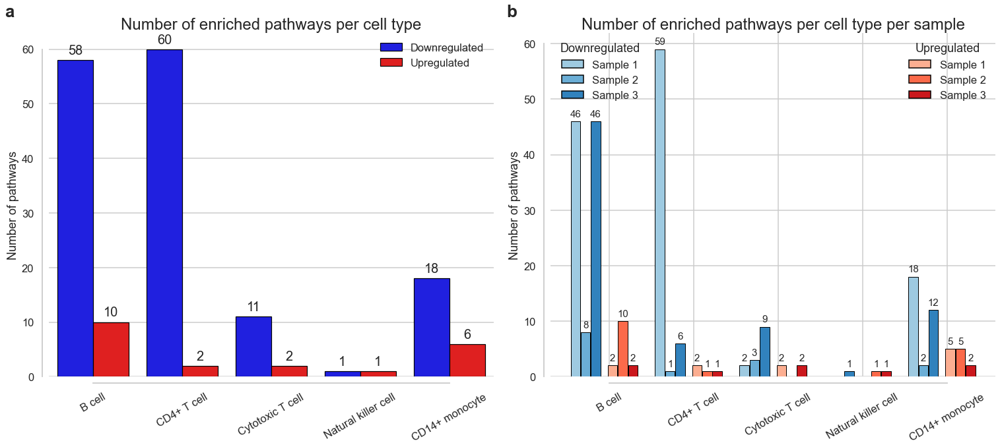


✅ Final high-visibility figure saved to: plots/sup_pathway_count.pdf


In [23]:
# ============================================================
# PSNP Pathway Regulation: Two-Panel Visualization (Final High-Visibility)
# ------------------------------------------------------------
# Panel (a): Unique up/downregulated pathways per cell type
# Panel (b): Per-sample counts split by regulation
#            Downregulated (blue shades) always appears first,
#            followed by Upregulated (red shades).
# Subpanel labels 'a' and 'b' are placed to the left of panels.
# Larger numeric annotations and rotated xticks (30°).
# ============================================================

import pandas as pd
import re
from collections import Counter
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
from matplotlib.patches import Patch

# ------------------------------------------------------------
# 1) CONFIGURATION
# ------------------------------------------------------------
csv_path = Path("results/gse_results_CoDi_dist.csv")
OUTPUT_DIR = Path("plots")
OUTPUT_DIR.mkdir(parents=True, exist_ok=True)

CELL_TYPES = [
    "B cell",
    "CD4+ T cell",
    "Cytotoxic T cell",
    "Natural killer cell",
    "CD14+ monocyte",
]

SAMPLES = [1, 2, 3]

# Shades per sample
BLUES = {1: "#9ecae1", 2: "#6baed6", 3: "#3182bd"}   # Downregulated
REDS  = {1: "#fcae91", 2: "#fb6a4a", 3: "#cb181d"}   # Upregulated

# ------------------------------------------------------------
# 2) HELPER FUNCTION
# ------------------------------------------------------------
def parse_marks(entry):
    """Parse entries such as '1↑,3↓' into list of tuples (sample, arrow)."""
    if pd.isna(entry) or not str(entry).strip():
        return []
    return [(int(sample), arrow) for sample, arrow in re.findall(r"(\d+)(↑|↓)", str(entry))]

# ------------------------------------------------------------
# 3) LOAD DATA + BUILD SUMMARY TABLES
# ------------------------------------------------------------
df = pd.read_csv(csv_path)
summary_rows = []
per_sample_rows = []

for ct in CELL_TYPES:
    per_sample_up = Counter()
    per_sample_down = Counter()
    pathways_up = set()
    pathways_down = set()

    for _, row in df.iterrows():
        marks = parse_marks(row.get(ct, ""))
        if not marks:
            continue
        term = row["Term"]
        for sample, arrow in marks:
            if arrow == "↑":
                per_sample_up[sample] += 1
                pathways_up.add(term)
            elif arrow == "↓":
                per_sample_down[sample] += 1
                pathways_down.add(term)

    # Unique summary
    summary_rows.append({
        "Cell type": ct,
        "Downregulated": len(pathways_down),
        "Upregulated": len(pathways_up)
    })

    # Per-sample counts
    for s in SAMPLES:
        per_sample_rows.append({
            "Cell type": ct,
            "Sample": s,
            "Downregulated": per_sample_down.get(s, 0),
            "Upregulated": per_sample_up.get(s, 0)
        })

summary_df = pd.DataFrame(summary_rows)
per_sample_df = pd.DataFrame(per_sample_rows)

# ------------------------------------------------------------
# 4) PLOTTING (Nature-style)
# ------------------------------------------------------------
sns.set(style="whitegrid", context="talk", font="Arial")
fig, axes = plt.subplots(1, 2, figsize=(22, 10), sharey=False)
order_ct = CELL_TYPES

# ------------------------------------------------------------
# PANEL (a): Unique pathways
# ------------------------------------------------------------
ax1 = axes[0]
plot_unique = pd.melt(summary_df, id_vars="Cell type", var_name="Regulation", value_name="Count")
plot_unique["Regulation"] = pd.Categorical(plot_unique["Regulation"], categories=["Downregulated", "Upregulated"], ordered=True)
palette_a = {"Downregulated": "blue", "Upregulated": "red"}

sns.barplot(
    data=plot_unique,
    x="Cell type", y="Count", hue="Regulation",
    order=order_ct, palette=palette_a,
    edgecolor="black", linewidth=1.2, ax=ax1
)

ax1.set_xlabel("")
ax1.set_ylabel("Number of pathways", fontsize=18)
ax1.tick_params(axis="x", labelrotation=30)
sns.despine(ax=ax1, offset=10, trim=True)
ax1.legend(title="", frameon=False, loc="upper right")
ax1.set_title("Number of enriched pathways per cell type", fontsize=24)

# Annotate counts (larger font)
for p in ax1.patches:
    h = p.get_height()
    if h > 0:
        ax1.text(p.get_x() + p.get_width()/2, h + 0.6, f"{int(h)}",
                 ha="center", va="bottom", fontsize=20, fontweight="medium")

# ------------------------------------------------------------
# PANEL (b): Per-sample shades
# ------------------------------------------------------------
ax2 = axes[1]
x = range(len(order_ct))
group_width = 0.8
gap_between_groups = 0.08
bars_per_group = 3
bar_width = (group_width - gap_between_groups) / (2 * bars_per_group)

# Build lookup
counts = {}
for _, r in per_sample_df.iterrows():
    counts.setdefault(r["Cell type"], {}).setdefault(int(r["Sample"]), {"Downregulated": 0, "Upregulated": 0})
    counts[r["Cell type"]][int(r["Sample"])]["Downregulated"] = r["Downregulated"]
    counts[r["Cell type"]][int(r["Sample"])]["Upregulated"] = r["Upregulated"]

# Draw bars
for i, ct in enumerate(order_ct):
    center = i
    # Left group: Downregulated
    for j, s in enumerate(SAMPLES):
        offset = -group_width/2 + j*bar_width
        h = counts.get(ct, {}).get(s, {}).get("Downregulated", 0)
        ax2.bar(center + offset, h, width=bar_width*0.95,
                color=BLUES[s], edgecolor="black", linewidth=1.0)
        if h > 0:
            ax2.text(center + offset, h + 0.5, f"{int(h)}",
                     ha="center", va="bottom", fontsize=15, fontweight="medium")
    # Gap then Upregulated group
    gap_offset = -group_width/2 + bars_per_group*bar_width + gap_between_groups
    for j, s in enumerate(SAMPLES):
        offset = gap_offset + j*bar_width
        h = counts.get(ct, {}).get(s, {}).get("Upregulated", 0)
        ax2.bar(center + offset, h, width=bar_width*0.95,
                color=REDS[s], edgecolor="black", linewidth=1.0)
        if h > 0:
            ax2.text(center + offset, h + 0.5, f"{int(h)}",
                     ha="center", va="bottom", fontsize=15, fontweight="medium")

# Axis formatting
ax2.set_xlabel("")
ax2.set_ylabel("Number of pathways", fontsize=18)
ax2.set_xticks(list(x))
ax2.set_xticklabels(order_ct)
ax2.tick_params(axis="x", labelrotation=30) # ✅ rotated 30°
sns.despine(ax=ax2, offset=10, trim=True)

# Legends (Down left, Up right)
blue_patches = [Patch(facecolor=BLUES[s], edgecolor="black", label=f"Sample {s}") for s in SAMPLES]
red_patches  = [Patch(facecolor=REDS[s],  edgecolor="black", label=f"Sample {s}") for s in SAMPLES]
legend1 = ax2.legend(handles=blue_patches, title="Downregulated", frameon=False, loc="upper left")
ax2.add_artist(legend1)
ax2.legend(handles=red_patches, title="Upregulated", frameon=False, loc="upper right")
ax2.set_title("Number of enriched pathways per cell type per sample", fontsize=24)

# ------------------------------------------------------------
# SUBPANEL LABELS (outside)
# ------------------------------------------------------------
fig.text(0.04, 0.95, "a", fontsize=26, fontweight="bold", va="top", ha="left")
fig.text(0.52, 0.95, "b", fontsize=26, fontweight="bold", va="top", ha="left")

plt.tight_layout(rect=[0.03, 0, 1, 0.95])
output_fig = OUTPUT_DIR / "sup_pathway_count.pdf"
plt.savefig(output_fig, dpi=600)
plt.show()

print(f"\n✅ Final high-visibility figure saved to: {output_fig}")


# Genes from THP-1 study

In [7]:
from collections import Counter
import matplotlib.pyplot as plt
import scanpy as sc
import numpy as np
from matplotlib.colors import Normalize, to_rgba
from matplotlib import colormaps  # updated import for colormap
import matplotlib
import matplotlib.patches as mpatches
from matplotlib.cm import ScalarMappable

matplotlib.rcParams['font.family'] = 'Arial'
display_genes = ["SERPINB2", "CXCL1", "XAF1", "FLI1"]
#     'SOD2',  'HMOX1', # 'SOD1', 'CAT', 'GPX1',
#                 'IL1A', 'IL1B', 'BCL2', # , 'BAX', 'CASP3' 'CDKN1A',
#                   'IL6']  # 'GAPDH', 'PGF',
cell_type_of_interest = 'Natural killer cell'
# Assuming: 
# - adata_list is a list of AnnData objects
# - each adata in adata_list has UMAP computed
# - display_genes is a list of genes to show

n_genes = len(display_genes)
n_samples = len(adata_list)
n_rows = 1 + n_genes

fig, axes = plt.subplots(n_rows, n_samples, figsize=(4 * n_samples, 4 * n_rows), squeeze=False)


all_cell_types = ['B cell', 'CD14+ monocyte', 'CD4+ T cell', 'Cytotoxic T cell', 'Natural killer cell']



# Create color mapping: red for "cell_type_of_interest", others from colormap
cmap_base = colormaps.get_cmap("tab10")  # updated line
color_dict = {ct: cmap_base(i ) for i, ct in enumerate(all_cell_types)}
# color_dict[cell_type_of_interest] = to_rgba("red")

# First row: Seurat UMAP with B cell red, others colored
for j, adata in enumerate(adata_list):
    ax = axes[0][j]
    adata = adata[adata.obs['CoDi_dist'].isin(all_cell_types)]
    cell_types = adata.obs['CoDi_dist']
    colors = [color_dict.get(ct, to_rgba("gray")) for ct in cell_types]

    ax.scatter(
        adata.obsm["X_umap"][:, 0],
        adata.obsm["X_umap"][:, 1],
        c=colors,
        s=6,
        linewidths=0
    )
    ax.set_title(f"Sample {j+1} - Cell Types")# ({cell_type_of_interest} = red)")
    ax.axis("off")

# Remaining rows: gene expression UMAPs
for i, gene in enumerate(display_genes):
    for j, adata in enumerate(adata_list):
        ax = axes[i + 1][j]

        expr = adata[:, gene].X
        if hasattr(expr, "toarray"):
            expr = expr.toarray().flatten()
        else:
            expr = np.array(expr).flatten()

        if np.any(expr > 0):
            norm = Normalize(vmin=expr[expr > 0].min(), vmax=expr.max())
        else:
            norm = Normalize(vmin=0, vmax=1)

        cmap = plt.cm.Reds
        gray_rgba = to_rgba("#D3D3D3")

        colors = [
            gray_rgba if val == 0 else cmap(norm(val))
            for val in expr
        ]

        ax.scatter(
            adata.obsm["X_umap"][:, 0],
            adata.obsm["X_umap"][:, 1],
            c=colors,
            s=6,
            linewidths=0
        )
        ax.set_title(f"Sample {j+1} - {gene}")
        ax.axis("off")

# Create legend handles
legend_patches = [mpatches.Patch(color=color_dict[ct], label=ct) for ct in color_dict]

# Add legend to the first row, first plot (or anywhere appropriate)
axes[0][0].legend(
    handles=legend_patches,
    bbox_to_anchor=(1.05, 1),
    loc='upper left',
    borderaxespad=0.,
    fontsize='small',
    title="Cell Types"
)

# # Create a dummy mappable for the colorbar
# sm = ScalarMappable(cmap=plt.cm.Reds, norm=Normalize(vmin=0, vmax=1))
# sm.set_array([])

# # Position the colorbar next to the last column
# cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # [left, bottom, width, height]
# cbar = fig.colorbar(sm, cax=cbar_ax)
# cbar.set_label("Gene Expression", fontsize='medium')

# Add colorbar for only the first gene (row index 1)

first_adata = adata_list[0]

# Get expression data
expr = first_adata[:, 0].X
if hasattr(expr, "toarray"):
    expr = expr.toarray().flatten()
else:
    expr = np.array(expr).flatten()

if np.any(expr > 0):
    norm = Normalize(vmin=expr[expr > 0].min(), vmax=expr.max())
else:
    norm = Normalize(vmin=0, vmax=1)

sm = ScalarMappable(cmap=plt.cm.Reds, norm=norm)
sm.set_array([])

# Add colorbar next to first subplot of first gene row
cbar = fig.colorbar(sm, ax=axes[1][0], fraction=0.046, pad=0.04)
cbar.set_label(f"Normalized log-transformed gene expression", fontsize='medium')

# Panel labels: 'a' for first row, 'b', 'c', ... for gene expression rows
row_labels = ['a'] + ['b']

for i, label in enumerate(row_labels):
    # Add label to the left of the first plot in each row
    ax = axes[i][0]
    ax.text(
        -0.1, 1.05, label, transform=ax.transAxes,
        fontsize=26, va='top', ha='right'
    )
    
plt.tight_layout()
plt.savefig('./plots/nano_genes.pdf', dpi=300, bbox_inches='tight')
plt.show()

In [21]:
# Merge all genes to one file - for potential integrad DE - not used currently
for f in ["./results/gse_results_Seurat.xlsx", './results/gse_results_CoDi.xlsx','./results/gse_results_CoDi_dist.xlsx']:
    xls = pd.ExcelFile(f)

    # Find empty sheets
    merged_data = []
    for sheet_name in xls.sheet_names:
        df = xls.parse(sheet_name)
        if not df.empty:
            parts = sheet_name.rsplit('_sample_', 1)
            if len(parts) == 2:
                cell_type, sample_id = parts[0].replace('_', ' '), parts[1]
                df['Cell Type'] = cell_type
                df['Sample'] = sample_id
            merged_data.append(df)
    
    # Merge all DataFrames into a single DataFrame
    final_df = pd.concat(merged_data, ignore_index=True)
    final_df['NES'] = final_df['NES'].apply(lambda x: np.round(x, 4)).astype(float)
    final_df['FDR q-val'] = final_df['FDR q-val'].apply(lambda x: np.round(x, 4)).astype(float)
    
    df_clean = final_df[['Term', 'Cell Type', 'Sample']]
    grouped = df_clean.groupby(['Term', 'Cell Type'])['Sample'] \
                .apply(lambda x: ','.join(map(str, sorted(set(x))))) \
                .unstack(fill_value='').astype(str)
    col = grouped.pop("CD14+ monocyte")
    grouped["CD14+ monocyte"] = col
    by = list(filter(lambda x: x in grouped.columns, ['B cell', 'CD4+ T cell', 'Cytotoxic T cell', 'Natural killer cell', 'CD14+ monocyte']))
    
    grouped_df = grouped.sort_values(by=by, na_position='last', ascending=False)
    grouped_df.to_csv(f"./results/{f.split('_')[-1].replace('xlsx', 'csv')}", index=True)